# In Search Of Happiness: Where Is It?

People all over the world are looking for a recipe for happiness. People try to measure happiness like height or temperature.  
For example, [this report from Kaggle](https://www.kaggle.com/unsdsn/world-happiness?select=2019.csv) ranks 156 countries by their level of happiness on a 10-point scale.


## The World Happiness Report

Quoting Kaggle:

The World Happiness Report is a landmark survey of the state of global happiness. The first report was published in 2012, the second in 2013, the third in 2015, and the fourth in the 2016 Update. The World Happiness 2017, which ranks 155 countries by their happiness levels, was released at the United Nations at an event celebrating International Day of Happiness on March 20th. The report continues to gain global recognition as governments, organizations and civil society increasingly use happiness indicators to inform their policy-making decisions. Leading experts across fields – economics, psychology, survey analysis, national statistics, health, public policy and more – describe how measurements of well-being can be used effectively to assess the progress of nations. The reports review the state of happiness in the world today and show how the new science of happiness explains personal and national variations in happiness.

You can read more [here](https://www.kaggle.com/unsdsn/world-happiness).


## Introduction

Even in our search of happiness, we've never been interested in anything but the data.  
With The World Happiness Report, we would like to discover the happiest places.

We are most interested in the following columns:

- `Country or region` - country name
- `Overall rank` - country's place in the rating
- `Score` - happiness score

In this project, we'll do the following:

1. Generate a world happiness map.
2. Determine happiness by region and continent. 
3. Overview TOP5 rating of the happiest countries and the least happy countries.

As a result, we want to find out ***where*** *the happiest people live*.


## Reading The Report

In [1]:
# Import libs
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import geopandas as gpd # to plot the map
import seaborn as sns # for other plots

Let's take the latest report, published in 2019.  
We'll rename the columns according to the snake_case format.

In [2]:
# Set the width to display
pd.set_option('display.width', 120)
# Increase the number of rows to display
pd.set_option('display.max_rows', 180) 

# Get the data
happiness = pd.read_csv('data/happiness_2019.csv')

# Column map to rename
cols_dict = {'Country':'country',
             'Country or region':'country',
             'Region':'region',
             'Happiness Rank':'rank',
             'Happiness.Rank':'rank',
             'Overall rank':'rank',
             'Happiness Score':'score',
             'Happiness.Score':'score',
             'Score':'score',
             'Economy (GDP per Capita)':'gdp_per_capita',
             'Economy..GDP.per.Capita.':'gdp_per_capita',
             'GDP per capita':'gdp_per_capita',
             'Family':'family',
             'Freedom':'freedom',
             'Freedom to make life choices':'freedom',
             'Generosity':'generosity',
             'Health (Life Expectancy)':'life_expectancy',
             'Health..Life.Expectancy.':'life_expectancy',
             'Healthy life expectancy':'life_expectancy',
             'Perceptions of corruption':'trust_corruption',
             'Trust (Government Corruption)':'trust_corruption',
             'Trust..Government.Corruption.':'trust_corruption',
             'Social support':'social_support',
             'Dystopia Residual':'dystopia_residual',
             'Dystopia.Residual':'dystopia_residual',
             'Standard Error':'standard_error',
             'Upper Confidence Interval':'whisker_high',
             'Whisker.high':'whisker_high',
             'Lower Confidence Interval':'whisker_low',
             'Whisker.low':'whisker_low'
            }

happiness.rename(columns=cols_dict, inplace=True) # rename the columns

print(happiness.columns) # check the new column names

happiness.head() # check the values

Index(['rank', 'country', 'score', 'gdp_per_capita', 'social_support', 'life_expectancy', 'freedom', 'generosity',
       'trust_corruption'],
      dtype='object')


,rank,country,score,gdp_per_capita,social_support,life_expectancy,freedom,generosity,trust_corruption
0,1,Finland,7.769,1.340,1.587,0.986,0.596,0.153,0.393
1,2,Denmark,7.600,1.383,1.573,0.996,0.592,0.252,0.410
2,3,Norway,7.554,1.488,1.582,1.028,0.603,0.271,0.341
3,4,Iceland,7.494,1.380,1.624,1.026,0.591,0.354,0.118
4,5,Netherlands,7.488,1.396,1.522,0.999,0.557,0.322,0.298


In [3]:
happiness.tail(10) # last ten rows

,rank,country,score,gdp_per_capita,social_support,life_expectancy,freedom,generosity,trust_corruption
146,147,Haiti,3.597,0.323,0.688,0.449,0.026,0.419,0.110
147,148,Botswana,3.488,1.041,1.145,0.538,0.455,0.025,0.100
148,149,Syria,3.462,0.619,0.378,0.440,0.013,0.331,0.141
149,150,Malawi,3.410,0.191,0.560,0.495,0.443,0.218,0.089
150,151,Yemen,3.380,0.287,1.163,0.463,0.143,0.108,0.077
151,152,Rwanda,3.334,0.359,0.711,0.614,0.555,0.217,0.411
152,153,Tanzania,3.231,0.476,0.885,0.499,0.417,0.276,0.147
153,154,Afghanistan,3.203,0.350,0.517,0.361,0.000,0.158,0.025
154,155,Central African Republic,3.083,0.026,0.000,0.105,0.225,0.235,0.035
155,156,South Sudan,2.853,0.306,0.575,0.295,0.010,0.202,0.091


In [4]:
happiness.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 156 entries, 0 to 155
Data columns (total 9 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   rank              156 non-null    int64  
 1   country           156 non-null    object 
 2   score             156 non-null    float64
 3   gdp_per_capita    156 non-null    float64
 4   social_support    156 non-null    float64
 5   life_expectancy   156 non-null    float64
 6   freedom           156 non-null    float64
 7   generosity        156 non-null    float64
 8   trust_corruption  156 non-null    float64
dtypes: float64(7), int64(1), object(1)
memory usage: 11.1+ KB


We see 156 countries in the report. Fortunately, there is no any missing values. All columns except the `country` were successfully casted to a numeric type.

Let's check for duplicates.

In [5]:
# Duplicated
print('Duplicated: {}'.format(happiness.duplicated(subset='country').sum()))

Duplicated: 0


It's all right.
Let's continue with the plots.


## The World Happiness Map

We want to display a map of the world and overview how the happiness scores are distributed on it.  
We'll get the borders of countries from [Natural Earth Data](http://www.naturalearthdata.com/downloads/10m-cultural-vectors/).  

We'll create a GeoDataFrame from the `Admin 0 - Countries` shapefile.  
Here are some notes on the Natural Earth's data:

- Natural Earth uses `UTF-8` character encoding to support internationalization with a full range of language scripts.
- The projection specified in the `PRJ` file is `WGS84`, which is `EPSG:4326`.

We'll only be interested in the following columns:

- `NAME_LONG` - full name of the country
- `NAME` - name of the country
- `GEOUNIT` - label for the territory
- `ADM0_A3` - the 3-letter country codes defined in ISO 3166-1 alpha-3
- `CONTINENT`
- `SUBREGION` - subregion the country belongs to
- `REGION_WB` - region the country belongs to
- `LEVEL` - level of detail
- `geometry` - the country shapes as polygons

In [6]:
file_shape = 'data/ne_10m_admin_0_countries_lakes/ne_10m_admin_0_countries_lakes.shp' # the shape file

cols = ['NAME_LONG', 'NAME', 'GEOUNIT', 'ADM0_A3', 'CONTINENT', 'SUBREGION', 'REGION_WB', 'LEVEL', 'geometry']

# Read the shapes
countries = gpd.read_file(file_shape)
countries = countries[cols].to_crs('EPSG:4326')

# Convert column names to lowercase
countries.columns = countries.columns.str.lower()

countries.sample(5, random_state=1) # check the values randomly

,name_long,name,geounit,adm0_a3,continent,subregion,region_wb,level,geometry
182,Aruba,Aruba,Aruba,ABW,North America,Caribbean,Latin America & Caribbean,2,"POLYGON ((-69.99694 12.57758, -69.93639 12.531..."
34,Ukraine,Ukraine,Ukraine,UKR,Europe,Eastern Europe,Europe & Central Asia,2,"MULTIPOLYGON (((31.76434 52.10057, 31.82584 52..."
110,Thailand,Thailand,Thailand,THA,Asia,South-Eastern Asia,East Asia & Pacific,2,"MULTIPOLYGON (((102.91358 11.64590, 102.90602 ..."
112,Haiti,Haiti,Haiti,HTI,North America,Caribbean,Latin America & Caribbean,2,"MULTIPOLYGON (((-71.75744 19.71011, -71.74861 ..."
226,British Indian Ocean Territory,Br. Indian Ocean Ter.,British Indian Ocean Territory,IOT,Seven seas (open ocean),Seven seas (open ocean),Sub-Saharan Africa,2,"MULTIPOLYGON (((72.46754 -7.38388, 72.47153 -7..."


In [7]:
countries.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 255 entries, 0 to 254
Data columns (total 9 columns):
 #   Column     Non-Null Count  Dtype   
---  ------     --------------  -----   
 0   name_long  255 non-null    object  
 1   name       255 non-null    object  
 2   geounit    255 non-null    object  
 3   adm0_a3    255 non-null    object  
 4   continent  255 non-null    object  
 5   subregion  255 non-null    object  
 6   region_wb  255 non-null    object  
 7   level      255 non-null    int64   
 8   geometry   255 non-null    geometry
dtypes: geometry(1), int64(1), object(7)
memory usage: 18.1+ KB


There are 255 countries, and there are no empty values for them.

According to the [`How-to` section](https://www.naturalearthdata.com/downloads/10m-cultural-vectors/10m-admin-0-details/), let's check that the borders are at the country level, i.e. the `level` equal to 2.

In [8]:
print('Level of detail: {}'.format(countries['level'].value_counts()))

Level of detail: 2    255
Name: level, dtype: int64


Now, we can merge geo data with happiness data.  

First, we need to check the columns that will be used for merging.  
Country names may differ in data sets, for instance, `eSwatini` and `Swaziland`, `Trinidad and Tobago` and `Trinidad & Tobago`. In this case, the rows will not match.

Let's compare the `geounit` column and the `country` column of the `happiness` data set.  
To do this, we'll combine two data sets using `outer` join.

In [9]:
cols_check = ['country', 'geounit']
happiness_geo = countries.merge(happiness, left_on='geounit', right_on='country', how='outer')[cols_check]
happiness_geo[happiness_geo.isnull().any(axis=1)].sort_values(by='country') # the countries don't match

,country,geounit
261,Congo (Brazzaville),NaN
263,Congo (Kinshasa),NaN
256,Czech Republic,NaN
259,Hong Kong,NaN
260,North Macedonia,NaN
262,Palestinian Territories,NaN
258,Serbia,NaN
264,Swaziland,NaN
257,Trinidad & Tobago,NaN
255,United States,NaN


To provide the same country names:

- Create a dictionary mapping all names to the values in the `happiness` dataset since we explore the happiness data.
- Store the `geounit` column in a new column `country`.
- Rename the countries by replacing the values in the new `country` column according to the map dictionary.

In [10]:
# Countries map to rename
country_to_rename = {'Republic of the Congo':'Congo (Brazzaville)',
                     'Democratic Republic of the Congo':'Congo (Kinshasa)',
                     'Czechia':'Czech Republic',
                     'Hong Kong S.A.R.':'Hong Kong',
                     'Macedonia':'North Macedonia',
                     'Palestine':'Palestinian Territories',
                     'Republic of Serbia':'Serbia',
                     'eSwatini':'Swaziland',
                     'Trinidad and Tobago':'Trinidad & Tobago',
                     'United States of America':'United States'
                    }

countries['country'] = countries['geounit']
countries['country'].replace(country_to_rename, inplace=True) # rename

countries.sample(5, random_state=3) # check the values randomly

,name_long,name,geounit,adm0_a3,continent,subregion,region_wb,level,geometry,country
16,Kenya,Kenya,Kenya,KEN,Africa,Eastern Africa,Sub-Saharan Africa,2,"MULTIPOLYGON (((33.97708 4.21969, 34.07816 4.3...",Kenya
31,Republic of the Congo,Congo,Republic of the Congo,COG,Africa,Middle Africa,Sub-Saharan Africa,2,"POLYGON ((18.62639 3.47687, 18.63455 3.44922, ...",Congo (Brazzaville)
140,Moldova,Moldova,Moldova,MDA,Europe,Eastern Europe,Europe & Central Asia,2,"POLYGON ((26.61789 48.25897, 26.61861 48.26718...",Moldova
65,Kosovo,Kosovo,Kosovo,KOS,Europe,Southern Europe,Europe & Central Asia,2,"POLYGON ((20.06496 42.54676, 20.07705 42.55991...",Kosovo
57,Cambodia,Cambodia,Cambodia,KHM,Asia,South-Eastern Asia,East Asia & Pacific,2,"MULTIPOLYGON (((107.52039 14.70458, 107.53243 ...",Cambodia


We can now use the new `country` column to merge the two datasets.

In [11]:
happiness_geo = countries.merge(happiness, on='country', how='outer').copy()

# Check for full match
print('Non-matching countries: {}'.format( happiness_geo[cols_check].isnull().any(axis=1).sum() )
     )

Non-matching countries: 0


In [12]:
happiness_geo.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
Int64Index: 255 entries, 0 to 254
Data columns (total 18 columns):
 #   Column            Non-Null Count  Dtype   
---  ------            --------------  -----   
 0   name_long         255 non-null    object  
 1   name              255 non-null    object  
 2   geounit           255 non-null    object  
 3   adm0_a3           255 non-null    object  
 4   continent         255 non-null    object  
 5   subregion         255 non-null    object  
 6   region_wb         255 non-null    object  
 7   level             255 non-null    int64   
 8   geometry          255 non-null    geometry
 9   country           255 non-null    object  
 10  rank              156 non-null    float64 
 11  score             156 non-null    float64 
 12  gdp_per_capita    156 non-null    float64 
 13  social_support    156 non-null    float64 
 14  life_expectancy   156 non-null    float64 
 15  freedom           156 non-null    float64 
 16  generosity        

There are 255 countries in total, 156 of them are ranked by their happiness levels.  

Let's create the World Happiness Map.

In [13]:
from mpl_toolkits.axes_grid1 import make_axes_locatable
%matplotlib inline

# Turn on svg rendering
%config InlineBackend.figure_format = 'svg'

# Color palette for the blog
snark_palette = ['#e0675a', # red
                 '#5ca0af', # green
                 '#edde7e', # yellow
                 '#211c47' # dark blue
                ]

In [14]:
# ***With GeoPandas***

# Color palette for the data
palette = 'BrBG'

# Inscriptions
title = 'World Happiness in 2019'

description = """
Countries with happiness scores on a 10-point scale based on answers to the main life evaluation question asked in the poll.
Data: Gallup World Poll - www.kaggle.com/unsdsn/world-happiness | Author: @data.sugar
"""

# Plot size
figsize = (8, 6)

# Create the plot
fig, ax = plt.subplots(1, 1, facecolor='w')
divider = make_axes_locatable(ax) # add colorbar
cax = divider.append_axes('right', size="2%", pad=0.1) # set colorbar

ax = happiness_geo.plot(column='score', figsize=figsize,
                        cmap=palette, legend=True,
                        missing_kwds={'color': 'lightgrey', # for non-rated countries
                                      'label':'missing values'
                                     },
                        alpha=0.9, facecolor='white',
                        ax=ax, cax=cax
                       )

# Set some aesthetic params for the plot
ax.set_title(title, fontdict={'fontsize': 14}, loc='left', c=snark_palette[-1]) # set a title of the plot
ax.annotate(description, xy=(0.03, 0.06), size=6, xycoords='figure fraction', c=snark_palette[-1])
ax.set_axis_off() # hide axes
ax.set_xlim([-170, 180])
ax.set_ylim([-65, 85])
cax.tick_params(colors=snark_palette[-1]) # color x ticks

# Save and plot
fig.subplots_adjust(bottom=0.025, top=0.88, left=0.025, right=0.9) # adjust for the post picture
plt.savefig('plot.pic/plot.happiness.map.png', dpi=150, bbox_inches='tight')
plt.show()

## Happiness by Continent and Region

It should be noted that we have only 156 ranked countries, not all countries in the world.  
With this in mind, let's continue with creating a happiness rating by continent/region.

We'll calculate the weighted average happiness score using the formula:  
    for each continent/region - $$\overline{score}_{continent/region} = {\displaystyle\sum_{i=1}^{n} score_{i} * population_{i} \over \displaystyle\sum_{i=1}^{n} population_{i}},$$ where `n` - the number of ranked countries per continent/region.

The formula takes into account the population of each country in the region.

### Getting population by country

We'll take the population by country from [World Population Review](https://worldpopulationreview.com/#liveWorldPop).  
We have uploaded the data to the `population.csv` file.  
As we explore the happiness report for 2019, we should get the population for 2019.

Let's read the file and examine the data.

In [15]:
pop = pd.read_csv('data/population.csv')[['name', 'pop2019']]
pop['pop2019'] = pop['pop2019'] * 1000 # the population is given in thousands
pop.head()

,name,pop2019
0,China,1.433784e+09
1,India,1.366418e+09
2,United States,3.290649e+08
3,Indonesia,2.706256e+08
4,Pakistan,2.165653e+08


We'll select only the ranked countries and then combine them with the population data.

In [16]:
happiness_geo = happiness_geo[happiness_geo['score'].notnull()]

First, we need to check the key columns before merging.  
We'll compare the `country` column and the `name` column of the `pop` data set.

In [17]:
cols_check = ['geounit', 'country', 'name_pop']
happiness_geo_pop = happiness_geo.merge(pop, how='outer',
                                        left_on='country', right_on='name',
                                        suffixes=(None, '_pop')
                                       )[cols_check]
happiness_geo_pop[happiness_geo_pop.isnull().any(axis=1)] # the countries don't match

,geounit,country,name_pop
10,Palestine,Palestinian Territories,NaN
25,Republic of the Congo,Congo (Brazzaville),NaN
26,Democratic Republic of the Congo,Congo (Kinshasa),NaN
53,Macedonia,North Macedonia,NaN
56,Kosovo,Kosovo,NaN
140,Northern Cyprus,Northern Cyprus,NaN
149,Trinidad and Tobago,Trinidad & Tobago,NaN
156,NaN,NaN,DR Congo
157,NaN,NaN,Sudan
158,NaN,NaN,Angola


Let's bring these names to the same values:

As in the previous case, we'll do the following:

- Create a dictionary mapping all names to the values in the `happiness` dataset since we explore the happiness data.
- Store the `name` column in a new column `country`.
- Rename the countries by replacing the values in the new `country` column according to the map dictionary.

In [18]:
# Countries map to rename
country_to_rename = {'Palestine':'Palestinian Territories',
                     'Republic of the Congo':'Congo (Brazzaville)',
                     'DR Congo':'Congo (Kinshasa)',
                     'Macedonia':'North Macedonia',
                     'Trinidad and Tobago':'Trinidad & Tobago'
                    }

pop['country'] = pop['name']
pop['country'].replace(country_to_rename, inplace=True) # rename

pop.sample(5, random_state=3) # check the values randomly

,name,pop2019,country
199,Antigua and Barbuda,97118.0,Antigua and Barbuda
61,Chile,18952038.0,Chile
15,DR Congo,86790567.0,Congo (Kinshasa)
170,Suriname,581372.0,Suriname
3,Indonesia,270625568.0,Indonesia


Let's combine the happiness data with the population.

In [19]:
happiness_geo_pop = happiness_geo.merge(pop, how='left', on='country', suffixes=(None, '_pop'))
happiness_geo_pop[happiness_geo_pop.isnull().any(axis=1)] # Check for full match

,name_long,name,geounit,adm0_a3,continent,subregion,region_wb,level,geometry,country,rank,score,gdp_per_capita,social_support,life_expectancy,freedom,generosity,trust_corruption,name_pop,pop2019
56,Kosovo,Kosovo,Kosovo,KOS,Europe,Southern Europe,Europe & Central Asia,2,"POLYGON ((20.06496 42.54676, 20.07705 42.55991...",Kosovo,46.0,6.100,0.882,1.232,0.758,0.489,0.262,0.006,NaN,NaN
140,Northern Cyprus,N. Cyprus,Northern Cyprus,CYN,Asia,Western Asia,Europe & Central Asia,2,"MULTIPOLYGON (((33.90651 35.06910, 33.90825 35...",Northern Cyprus,64.0,5.718,1.263,1.252,1.042,0.417,0.191,0.162,NaN,NaN


`Kosovo` and `Northern Cyprus` are disputed area and are not presented in the World Population Review report.  
We should also clarify the population for related countries: Serbia and Cyprus, respectively.
So, we'll fill in the popualtion for these areas from the following resources:

- [Wikipedia Northern Cyprus](https://en.wikipedia.org/wiki/Northern_Cyprus)
- [Wikipedia Demographics of Cyprus](https://en.wikipedia.org/wiki/Demographics_of_Cyprus#Population)
- [Wikipedia Demographics of Serbia](https://en.wikipedia.org/wiki/Demographics_of_Serbia)
- [Wikipedia Demographics of Kosovo](https://en.wikipedia.org/wiki/Demographics_of_Kosovo) 

In [20]:
pop2019_update = {'Kosovo':1788891,
                  'Northern Cyprus':326000,
                  'Cyprus':888000,
                  'Serbia':6945235
                 }

for cntr in pop2019_update:
    happiness_geo_pop.loc[happiness_geo_pop['country'] == cntr, 'pop2019'] = pop2019_update[cntr]
    happiness_geo_pop.loc[happiness_geo_pop['country'] == cntr, 'name_pop'] = cntr

happiness_geo_pop[happiness_geo_pop['country'].isin(pop2019_update.keys())]

,name_long,name,geounit,adm0_a3,continent,subregion,region_wb,level,geometry,country,rank,score,gdp_per_capita,social_support,life_expectancy,freedom,generosity,trust_corruption,name_pop,pop2019
6,Cyprus,Cyprus,Cyprus,CYP,Asia,Western Asia,Europe & Central Asia,2,"MULTIPOLYGON (((33.78183 34.97622, 33.78094 34...",Cyprus,49.0,6.046,1.263,1.223,1.042,0.406,0.190,0.041,Cyprus,888000.0
56,Kosovo,Kosovo,Kosovo,KOS,Europe,Southern Europe,Europe & Central Asia,2,"POLYGON ((20.06496 42.54676, 20.07705 42.55991...",Kosovo,46.0,6.100,0.882,1.232,0.758,0.489,0.262,0.006,Kosovo,1788891.0
84,Serbia,Serbia,Republic of Serbia,SRB,Europe,Southern Europe,Europe & Central Asia,2,"POLYGON ((20.24283 46.10809, 20.30566 46.05357...",Serbia,70.0,5.603,1.004,1.383,0.854,0.282,0.137,0.039,Serbia,6945235.0
140,Northern Cyprus,N. Cyprus,Northern Cyprus,CYN,Asia,Western Asia,Europe & Central Asia,2,"MULTIPOLYGON (((33.90651 35.06910, 33.90825 35...",Northern Cyprus,64.0,5.718,1.263,1.252,1.042,0.417,0.191,0.162,Northern Cyprus,326000.0


Below, we'll check the prepared data.

In [21]:
happiness_geo_pop.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
Int64Index: 156 entries, 0 to 155
Data columns (total 20 columns):
 #   Column            Non-Null Count  Dtype   
---  ------            --------------  -----   
 0   name_long         156 non-null    object  
 1   name              156 non-null    object  
 2   geounit           156 non-null    object  
 3   adm0_a3           156 non-null    object  
 4   continent         156 non-null    object  
 5   subregion         156 non-null    object  
 6   region_wb         156 non-null    object  
 7   level             156 non-null    int64   
 8   geometry          156 non-null    geometry
 9   country           156 non-null    object  
 10  rank              156 non-null    float64 
 11  score             156 non-null    float64 
 12  gdp_per_capita    156 non-null    float64 
 13  social_support    156 non-null    float64 
 14  life_expectancy   156 non-null    float64 
 15  freedom           156 non-null    float64 
 16  generosity        

We have 156 countries with non-empty variables.  
Let's compute the weighted mean happiness scores by continent and region.

### Calculating the weighted average happiness score

In [22]:
# Define the weighted mean function according to the above formula
mean_weighted = lambda x: np.average(x, weights=happiness_geo_pop.loc[x.index, 'pop2019'])

By continent:

In [23]:
happiness_pv_cont = happiness_geo_pop.pivot_table(values='score', index='continent',
                                                  aggfunc=mean_weighted, margins=True
                                                 )
happiness_pv_cont = happiness_pv_cont.reset_index().sort_values(by='score', ascending=False)
happiness_pv_cont

,continent,score
4,Oceania,7.240601
3,North America,6.701422
2,Europe,6.244879
6,South America,6.075897
5,Seven seas (open ocean),5.888000
7,All,5.153392
1,Asia,4.853096
0,Africa,4.513597


By region:

In [24]:
happiness_pv_reg = happiness_geo_pop.pivot_table(values='score', index='region_wb',
                                                 aggfunc=mean_weighted, margins=True
                                                )
happiness_pv_reg = happiness_pv_reg.reset_index().sort_values(by='score', ascending=False)
happiness_pv_reg

,region_wb,score
4,North America,6.931404
2,Latin America & Caribbean,6.144310
1,Europe & Central Asia,6.108598
0,East Asia & Pacific,5.309077
7,All,5.153392
3,Middle East & North Africa,4.755963
6,Sub-Saharan Africa,4.489247
5,South Asia,4.249219


Next, we'll plot the ratings.

## Happiness Rating by Continent

In [25]:
%matplotlib inline

# Turn on svg rendering
%config InlineBackend.figure_format = 'svg'

# Color palette for the blog
snark_palette = ['#e0675a', # red
                 '#5ca0af', # green
                 '#edde7e', # yellow
                 '#211c47' # dark blue
                ]

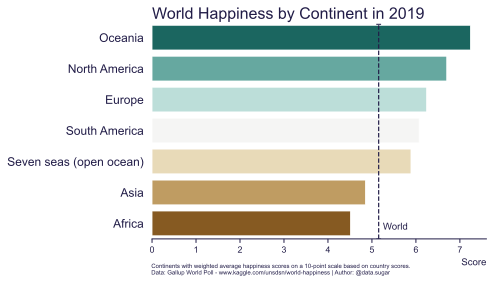

In [26]:
# Color palette for the data
palette = 'BrBG_r'

# Inscriptions
title = """World Happiness by Continent in 2019"""
description = """
Continents with weighted average happiness scores on a 10-point scale based on country scores.
Data: Gallup World Poll - www.kaggle.com/unsdsn/world-happiness | Author: @data.sugar
"""

# Plot size
figsize = (6,4)

# Set the figure
sns.set(context='paper', style='ticks', palette='BrBG',
        rc={'xtick.major.size': 4, 'ytick.left':False,
            'axes.spines.left': False, 'axes.spines.bottom': True,
            'axes.spines.right': False, 'axes.spines.top': False
           }
       )

# Create the plot
f, ax = plt.subplots(1, 1, figsize=figsize, facecolor='w')
sns.barplot(x='score', y='continent',
            data=happiness_pv_cont[happiness_pv_cont['continent'] != 'All'],
            orient='h', palette=palette, ax=ax
           )
ax.axvline(x=happiness_pv_cont.loc[(happiness_pv_cont['continent'] == 'All'), 'score'].item(),
           ymin=0, ymax=0.99,
           marker='_', linestyle='--',
           color=snark_palette[-1], label='World'
          ) # World score

# Set some aesthetic params for the plot
ax.set_title(title, fontdict={'fontsize': 16}, loc='left', pad=0, c=snark_palette[-1]) # set a title of the plot
ax.annotate(description, xy=(0.305, 0.004), size=6, xycoords='figure fraction', c=snark_palette[-1])
ax.text(s='World', x=5.25, y=6.2, c=snark_palette[-1]) # set label for the World score
ax.set_xlabel('Score', loc='right', c=snark_palette[-1]) # set label of x axis
ax.set_ylabel('') # set label of x axis
ax.tick_params(axis='x', colors=snark_palette[-1]) # color x ticks
ax.tick_params(axis='y', labelsize=12, colors=snark_palette[-1]) # set y ticks
ax.spines['bottom'].set_color(snark_palette[-1]) # color x axis

# Save and plot
fig.subplots_adjust(bottom=0.025, top=0.88, left=0.025, right=0.9) # adjust for the post picture
plt.savefig('plot.pic/plot.happiness.continent.png', dpi=150, bbox_inches='tight')
plt.show()

## Happiness Rating by Region

In [27]:
%matplotlib inline

# Turn on svg rendering
%config InlineBackend.figure_format = 'svg'

# Color palette for the blog
snark_palette = ['#e0675a', # red
                 '#5ca0af', # green
                 '#edde7e', # yellow
                 '#211c47' # dark blue
                ]

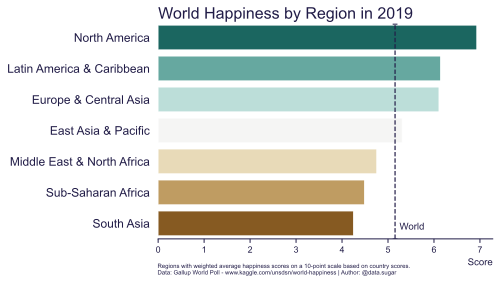

In [28]:
# Color palette for the data
palette = 'BrBG_r'

# Inscriptions
title = """World Happiness by Region in 2019"""
description = """
Regions with weighted average happiness scores on a 10-point scale based on country scores.
Data: Gallup World Poll - www.kaggle.com/unsdsn/world-happiness | Author: @data.sugar
"""

# Plot size
figsize = (6,4)

# Set the figure
sns.set(context='paper', style='ticks', palette='BrBG',
        rc={'xtick.major.size': 4, 'ytick.left':False,
            'axes.spines.left': False, 'axes.spines.bottom': True,
            'axes.spines.right': False, 'axes.spines.top': False
           }
       )

# Create the plot
f, ax = plt.subplots(1, 1, figsize=figsize, facecolor='w')
sns.barplot(x='score', y='region_wb',
            data=happiness_pv_reg[happiness_pv_reg['region_wb'] != 'All'],
            orient='h', palette=palette, ax=ax
           )
ax.axvline(x=happiness_pv_reg.loc[(happiness_pv_reg['region_wb'] == 'All'), 'score'].item(),
           ymin=0, ymax=0.99,
           marker='_', linestyle='--',
           color=snark_palette[-1], label='World'
          ) # World score

# Set some aesthetic params for the plot
ax.set_title(title, fontdict={'fontsize': 16}, loc='left', pad=0, c=snark_palette[-1]) # set a title of the plot
ax.annotate(description, xy=(0.315, 0.004), size=6, xycoords='figure fraction', c=snark_palette[-1])
ax.text(s='World', x=5.25, y=6.2, c=snark_palette[-1]) # set label for the World score
ax.set_xlabel('Score', loc='right', c=snark_palette[-1]) # set label of x axis
ax.set_ylabel('') # set label of x axis
ax.tick_params(axis='x', colors=snark_palette[-1]) # color x ticks
ax.tick_params(axis='y', labelsize=12, colors=snark_palette[-1]) # set y ticks
ax.spines['bottom'].set_color(snark_palette[-1]) # color x axis

# Save and plot
fig.subplots_adjust(bottom=0.025, top=0.88, left=0.025, right=0.9) # adjust for the post picture
plt.savefig('plot.pic/plot.happiness.region.png', dpi=150, bbox_inches='tight')
plt.show()

## TOP5 Countries

Let's show the five countries with the highest happiness scores and the five with the lowest happiness scores.

In [29]:
happiness_top5 = (happiness_geo_pop[['country', 'rank', 'score']] # get only the required columns
                      .sort_values(by='score', ascending=False) # get the first 5 rows with the highest score 
                                                                #     and the last 5 rows with the lowest score
                      .iloc[[*range(5), *range(-5, 0)]] # select only the first and last 5 rows
                 )
happiness_top5

,country,rank,score
46,Finland,1.0,7.769
62,Denmark,2.0,7.600
44,Norway,3.0,7.554
148,Iceland,4.0,7.494
82,Netherlands,5.0,7.488
107,Rwanda,152.0,3.334
18,Tanzania,153.0,3.231
110,Afghanistan,154.0,3.203
76,Central African Republic,155.0,3.083
13,South Sudan,156.0,2.853


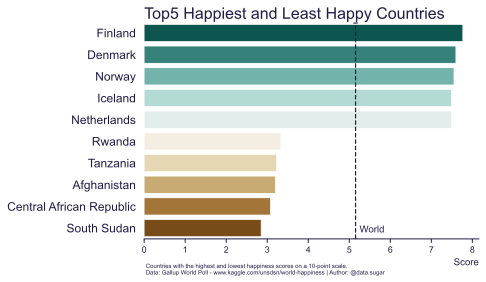

In [30]:
# Color palette for the data
palette = 'BrBG_r'

# Inscriptions
title = """Top5 Happiest and Least Happy Countries"""
description = """Countries with the highest and lowest happiness scores on a 10-point scale.
Data: Gallup World Poll - www.kaggle.com/unsdsn/world-happiness | Author: @data.sugar
"""

# Plot size
figsize = (6,4)

# Set the figure
sns.set(context='paper', style='ticks', palette='BrBG',
        rc={'xtick.major.size': 4, 'ytick.left':False,
            'axes.spines.left': False, 'axes.spines.bottom': True,
            'axes.spines.right': False, 'axes.spines.top': False
           }
       )

# Create the plot
f, ax = plt.subplots(1, 1, figsize=figsize, facecolor='w')
sns.barplot(x='score', y='country', data=happiness_top5,
            orient='h', palette=palette, ax=ax
           )
ax.axvline(x=happiness_pv_reg.loc[(happiness_pv_reg['region_wb'] == 'All'), 'score'].item(),
           ymin=0, ymax=0.996,
           marker='_', linestyle='--',
           color=snark_palette[-1], label='World'
          ) # World score

# Set some aesthetic params for the plot
ax.set_title(title, fontdict={'fontsize': 16}, loc='left', pad=0, c=snark_palette[-1]) # set a title of the plot
ax.annotate(description, xy=(0.3, 0.004), size=6, xycoords='figure fraction', c=snark_palette[-1])
ax.text(s='World', x=5.25, y=9.2, c=snark_palette[-1]) # set label for the World score
ax.set_xlabel('Score', loc='right', c=snark_palette[-1]) # set label of x axis
ax.set_ylabel('') # set label of x axis
ax.tick_params(axis='x', colors=snark_palette[-1]) # color x ticks
ax.tick_params(axis='y', labelsize=12, colors=snark_palette[-1]) # set y ticks
ax.spines['bottom'].set_color(snark_palette[-1]) # color x axis

# Save and plot
fig.subplots_adjust(bottom=0.025, top=0.88, left=0.025, right=0.9) # adjust for the post picture
plt.savefig('plot.pic/plot.happiness.top5.png', dpi=150, bbox_inches='tight')
plt.show()

## Conclusions

Here are our thoughts on the World Happiness Map.  

Let's distinguish three groups of cultures: [Western culture, Eastern culture](https://en.wikipedia.org/wiki/East%E2%80%93West_dichotomy) and others.  

On the map, the happiest areas are those where Western culture has the greatest influence on people's minds.  

There are many different cultures in Africa. Eastern culture, for example, covers India and China. Russia or the countries of South America belong to mixed cultures, where, however, the influence of Western values is felt.  

It seems that the countries where Western culture is widespread are the happiest.  

However, we would say that the method of evaluating happiness is most likely not suitable for evaluating the happiness of other cultures, and the map reflects more the spread of Western culture in the world than happiness.  

Notwithstanding, we are surprised that the least happy region is South Asia.


# Blog Post

In [31]:
blog_post = r"""
## IN SEARCH OF 🎈HAPPINESS: 🌍WHERE?  
  
💪With this post we start our happiness challenge!  

👀Happiness is the most uncertain thing.  
People all over the world are looking for a recipe for happiness.  
People try to measure happiness like height or temperature.  
For example, The World Happiness Report from Kaggle ranks 156 countries by their level of happiness on a 10-point scale.  
Even in our search of happiness, we've also never been interested in anything but the data.  

📌We would like to discover the happiest places!  

Here are our thoughts on the World Happiness Map.  

Let's distinguish three groups of cultures: Western culture, Eastern culture and others.  
On the map, the happiest areas are those where Western culture has the greatest influence on people's minds.  
There are many different cultures in Africa.  
Eastern culture, for example, covers India and China.  
Russia or the countries of South America belong to mixed cultures, where, however, the influence of Western values is felt.  

It seems that the countries where Western culture is widespread are the happiest.  
However, we would say that the method of evaluating happiness is most likely not suitable for evaluating the happiness of other cultures, and the map reflects more the spread of Western culture in the world than happiness.  

Does it surprise you that the least happy region is South Asia?

(Interested in more details? Follow the link in bio for the entire research project!)  
.  
.  
.  
\#funtime \#probably \#datascience \#datapower \#data_sugar_happiness \#happy \#kaggle \#data_know_everything_and_nothing \#linkinbio \#datajournalism \#python
"""

# Check post text length for Instagram
len(blog_post)

1656

In [32]:
from IPython.display import Markdown as md
md(blog_post)


## IN SEARCH OF 🎈HAPPINESS: 🌍WHERE?  
  
💪With this post we start our happiness challenge!  

👀Happiness is the most uncertain thing.  
People all over the world are looking for a recipe for happiness.  
People try to measure happiness like height or temperature.  
For example, The World Happiness Report from Kaggle ranks 156 countries by their level of happiness on a 10-point scale.  
Even in our search of happiness, we've also never been interested in anything but the data.  

📌We would like to discover the happiest places!  

Here are our thoughts on the World Happiness Map.  

Let's distinguish three groups of cultures: Western culture, Eastern culture and others.  
On the map, the happiest areas are those where Western culture has the greatest influence on people's minds.  
There are many different cultures in Africa.  
Eastern culture, for example, covers India and China.  
Russia or the countries of South America belong to mixed cultures, where, however, the influence of Western values is felt.  

It seems that the countries where Western culture is widespread are the happiest.  
However, we would say that the method of evaluating happiness is most likely not suitable for evaluating the happiness of other cultures, and the map reflects more the spread of Western culture in the world than happiness.  

Does it surprise you that the least happy region is South Asia?

(Interested in more details? Follow the link in bio for the entire research project!)  
.  
.  
.  
\#funtime \#probably \#datascience \#datapower \#data_sugar_happiness \#happy \#kaggle \#data_know_everything_and_nothing \#linkinbio \#datajournalism \#python
